# Author : Kapil Wanaskar
# San Jose State University
# Student ID: 0166498890

In [ ]:
import pandas as pd
import numpy as np

In [ ]:
!pip install Pillow

In [ ]:
!pip install datasets

In [ ]:
import numpy as np
from datasets import load_dataset

# Load the dataset with the `2m_first_5k` subset
# we need to download dataset every time, so do not use random!
# use '2m_first_5k' for the consistency among the models
# for me (Hyelim), it takes about 3 min to download
dataset = load_dataset('poloclub/diffusiondb', '2m_first_5k')

Found cached dataset diffusiondb (/Users/spartan/.cache/huggingface/datasets/poloclub___diffusiondb/2m_first_5k/0.9.1/547894e3a57aa647ead68c9faf148324098f47f2bc1ab6705d670721de9d89d1)


  0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
my_5k_data = dataset['train']
df = pd.DataFrame( my_5k_data ) # this will take about 3 min too
df.head()

,image,prompt,seed,step,cfg,sampler,width,height,user_name,timestamp,image_nsfw,prompt_nsfw
0,<PIL.PngImagePlugin.PngImageFile image mode=RG...,"a renaissance portrait of dwayne johnson, art ...",2480545905,50,16.0,k_euler_ancestral,512,768,e9dfc969d22cb9c5621ad075b3826c28f18ef3840c6dda...,2022-08-20 05:28:00+00:00,0.163488,0.000793
1,<PIL.PngImagePlugin.PngImageFile image mode=RG...,"portrait of a dancing eagle woman, beautiful b...",2250159284,50,9.0,k_lms,512,640,aa60a36693bf9e079b421c1200fd42ed94061fb02078ad...,2022-08-20 05:28:00+00:00,0.276650,0.003090
2,<PIL.PngImagePlugin.PngImageFile image mode=RG...,"epic 3 d, become legend shiji! gpu mecha contr...",4292948605,50,7.0,k_lms,512,768,3e774662f24c78b0590d57365d755d7dacde8f33dbdc56...,2022-08-20 05:28:00+00:00,0.090421,0.000533
3,<PIL.PngImagePlugin.PngImageFile image mode=RG...,an airbrush painting of cyber war machine scen...,2374713726,50,12.0,k_lms,512,768,c2bd0b60caa0aa04d0a7e5972fefc60b21ece352d88353...,2022-08-20 05:29:00+00:00,0.078309,0.000597
4,<PIL.PngImagePlugin.PngImageFile image mode=RG...,concept art of a silent hill monster. painted ...,2320897141,50,6.0,k_lms,640,512,08ac4153ab7e13baa55ee74213eb117a29a0024267b29e...,2022-08-20 05:29:00+00:00,0.086802,0.083516


In [ ]:
df['id'] = df.index
first_column = df.pop('id')
df.insert(0, 'id', first_column)
df.head()

,id,image,prompt,seed,step,cfg,sampler,width,height,user_name,timestamp,image_nsfw,prompt_nsfw
0,0,<PIL.PngImagePlugin.PngImageFile image mode=RG...,"a renaissance portrait of dwayne johnson, art ...",2480545905,50,16.0,k_euler_ancestral,512,768,e9dfc969d22cb9c5621ad075b3826c28f18ef3840c6dda...,2022-08-20 05:28:00+00:00,0.163488,0.000793
1,1,<PIL.PngImagePlugin.PngImageFile image mode=RG...,"portrait of a dancing eagle woman, beautiful b...",2250159284,50,9.0,k_lms,512,640,aa60a36693bf9e079b421c1200fd42ed94061fb02078ad...,2022-08-20 05:28:00+00:00,0.276650,0.003090
2,2,<PIL.PngImagePlugin.PngImageFile image mode=RG...,"epic 3 d, become legend shiji! gpu mecha contr...",4292948605,50,7.0,k_lms,512,768,3e774662f24c78b0590d57365d755d7dacde8f33dbdc56...,2022-08-20 05:28:00+00:00,0.090421,0.000533
3,3,<PIL.PngImagePlugin.PngImageFile image mode=RG...,an airbrush painting of cyber war machine scen...,2374713726,50,12.0,k_lms,512,768,c2bd0b60caa0aa04d0a7e5972fefc60b21ece352d88353...,2022-08-20 05:29:00+00:00,0.078309,0.000597
4,4,<PIL.PngImagePlugin.PngImageFile image mode=RG...,concept art of a silent hill monster. painted ...,2320897141,50,6.0,k_lms,640,512,08ac4153ab7e13baa55ee74213eb117a29a0024267b29e...,2022-08-20 05:29:00+00:00,0.086802,0.083516


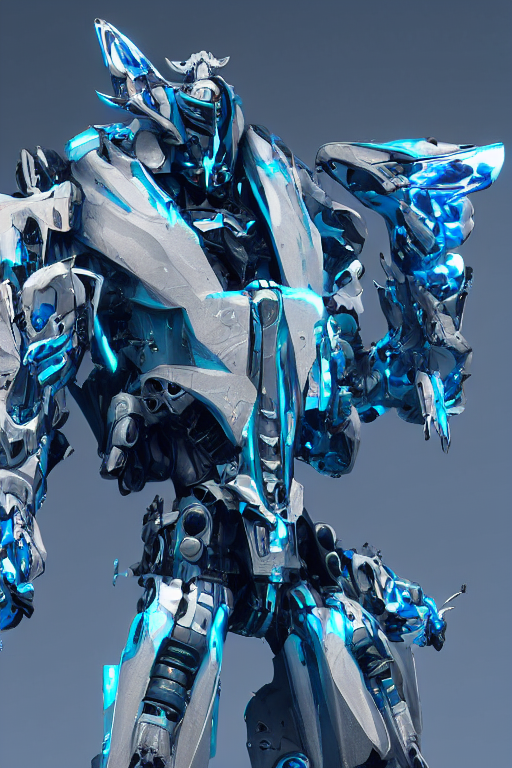

In [ ]:
image = df['image'][2]
image

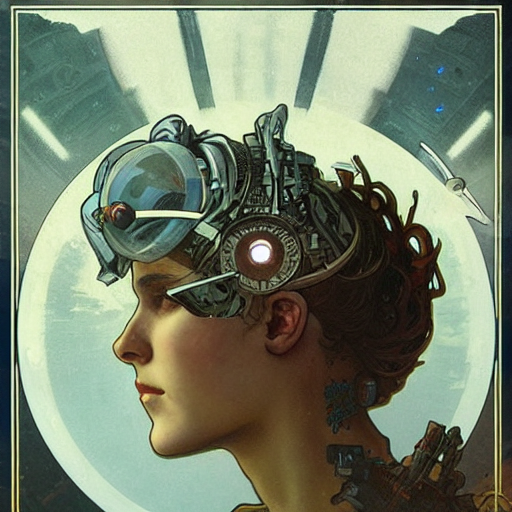

In [ ]:
image_random = df['image'][3845]
image_random

# Install dependencies

In [ ]:
!pip install emoji
!pip install emot
!pip install clean-text[gpl]
!pip install 
!pip install cleantext
!pip install plotly

zsh:1: no matches found: clean-text[gpl]
ERROR: You must give at least one requirement to install (see "pip help install")


## Prompt preprocessing

This code will open a file upload dialog. Select the 'Emoji_Dict.p' file from your local system to upload it.

# PROMPT PROCESSING

In [ ]:
import pandas as pd
import numpy as np
from sklearn.metrics.pairwise import cosine_distances
import re
import pickle
import emoji
import emot.emo_unicode
from cleantext import clean
import nltk
from nltk.tokenize import sent_tokenize, word_tokenize
from nltk.corpus import stopwords
import string

# Extract 'id' and 'prompt' columns
prompt = df[['id', 'prompt']]
prompt.head()

# Step (a) Convert emoji to word(s)
with open('Emoji_Dict.p', 'rb') as fp:
    Emoji_Dict = pickle.load(fp)
Emoji_Dict = {v: k for k, v in Emoji_Dict.items()}

import emoji

def convert_emojis_to_word_pd(row):
    if bool(emoji.emoji_count(row[1])):
        temp = row[1]
        temp = emoji.demojize(temp)
        temp = temp.replace(":", " ")
        return temp
    else:
        return row[1]

prompt['no_emojis'] = prompt.apply(convert_emojis_to_word_pd, axis = 1)


# Step (b) Remove stop words and stemming
nltk.download('stopwords')
nltk.download('punkt')

stopwords = stopwords.words('english')
stemmer = nltk.stem.PorterStemmer()

def remove_stopwords_stemming(row):
  special_characters = set(string.punctuation)
  text = ''.join(ch for ch in row[2] if ch not in special_characters and not ch.isnumeric())
  tokens = [word.lower() for sent in nltk.sent_tokenize(text) for word in nltk.word_tokenize(sent) if word.lower() not in stopwords]
  after_stemming = [stemmer.stem(token) for token in tokens]
  return ' '.join(after_stemming)

prompt['after_stemming'] = prompt.apply(remove_stopwords_stemming, axis = 1)

# Step (d) Add word count column
def word_count(row):
  temp = row[3]
  return len([s for s in temp.split(' ') if not s.isnumeric()])

prompt['word_count'] = prompt.apply(word_count, axis = 1)

# Step (e) Delete rows that have only numerical
index_to_drop = prompt[prompt['after_stemming'] == ''].index
prompt.drop(index_to_drop , inplace=True)

# Final cleaned DataFrame
df2 = prompt[prompt['word_count'] >= 2]

# Load pre-trained Word2Vec model
import gensim.downloader as api
word2vec_model = api.load("word2vec-google-news-300")

# Calculate embeddings for all prompts
df2['embedding'] = df2['after_stemming'].apply(lambda prompt: np.mean([word2vec_model[word] for word in prompt.split() if word in word2vec_model], axis=0))

# Remove rows with empty embeddings
df2 = df2[df2['embedding'].apply(lambda x: x.size != 1)]
df2

/var/folders/3m/l7h25c9d0mj46kv1xkbdmb0c0000gr/T/ipykernel_22807/2299009730.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prompt['no_emojis'] = prompt.apply(convert_emojis_to_word_pd, axis = 1)
[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/spartan/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /Users/spartan/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
/var/folders/3m/l7h25c9d0mj46kv1xkbdmb0c0000gr/T/ipykernel_22807/2299009730.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata

,id,prompt,no_emojis,after_stemming,word_count,embedding
0,0,"a renaissance portrait of dwayne johnson, art ...","a renaissance portrait of dwayne johnson, art ...",renaiss portrait dwayn johnson art style rembr...,27,"[0.06157112, 0.067028046, -0.05685997, 0.04724..."
1,1,"portrait of a dancing eagle woman, beautiful b...","portrait of a dancing eagle woman, beautiful b...",portrait danc eagl woman beauti blond hair lak...,36,"[0.06084373, 0.033072732, 0.026268005, 0.10508..."
2,2,"epic 3 d, become legend shiji! gpu mecha contr...","epic 3 d, become legend shiji! gpu mecha contr...",epic becom legend shiji gpu mecha control tele...,26,"[0.09508464, 0.017593574, -0.033842977, 0.0237..."
3,3,an airbrush painting of cyber war machine scen...,an airbrush painting of cyber war machine scen...,airbrush paint cyber war machin scene area des...,15,"[0.046588134, 0.12438355, -0.03583374, 0.05718..."
4,4,concept art of a silent hill monster. painted ...,concept art of a silent hill monster. painted ...,concept art silent hill monster paint edward h...,8,"[0.09681702, 0.10888672, 0.019823074, 0.164733..."
...,...,...,...,...,...,...
4995,4995,interior view overlooking a spectacular incred...,interior view overlooking a spectacular incred...,interior view overlook spectacular incred beau...,14,"[-0.0054955115, 0.030951867, -0.008598914, 0.1..."
4996,4996,"bob's burger in real life, realistic studio po...","bob's burger in real life, realistic studio po...",bob burger real life realist studio portrait p...,8,"[0.035095215, 0.091430664, -0.094436646, 0.170..."
4997,4997,"sushi, photography, by albert bierstadt","sushi, photography, by albert bierstadt",sushi photographi albert bierstadt,4,"[-0.15539551, 0.0859375, 0.040161133, 0.335937..."
4998,4998,a sky stream of white streamers in a sea of ch...,a sky stream of white streamers in a sea of ch...,sky stream white streamer sea cherri petal sta...,37,"[0.05635137, 0.07810908, -0.0032970593, -0.055..."


In [ ]:
# Processed PROMPT dataset
df_processed_prompt = df2 
df_processed_prompt

,id,prompt,no_emojis,after_stemming,word_count,embedding
0,0,"a renaissance portrait of dwayne johnson, art ...","a renaissance portrait of dwayne johnson, art ...",renaiss portrait dwayn johnson art style rembr...,27,"[0.06157112, 0.067028046, -0.05685997, 0.04724..."
1,1,"portrait of a dancing eagle woman, beautiful b...","portrait of a dancing eagle woman, beautiful b...",portrait danc eagl woman beauti blond hair lak...,36,"[0.06084373, 0.033072732, 0.026268005, 0.10508..."
2,2,"epic 3 d, become legend shiji! gpu mecha contr...","epic 3 d, become legend shiji! gpu mecha contr...",epic becom legend shiji gpu mecha control tele...,26,"[0.09508464, 0.017593574, -0.033842977, 0.0237..."
3,3,an airbrush painting of cyber war machine scen...,an airbrush painting of cyber war machine scen...,airbrush paint cyber war machin scene area des...,15,"[0.046588134, 0.12438355, -0.03583374, 0.05718..."
4,4,concept art of a silent hill monster. painted ...,concept art of a silent hill monster. painted ...,concept art silent hill monster paint edward h...,8,"[0.09681702, 0.10888672, 0.019823074, 0.164733..."
...,...,...,...,...,...,...
4995,4995,interior view overlooking a spectacular incred...,interior view overlooking a spectacular incred...,interior view overlook spectacular incred beau...,14,"[-0.0054955115, 0.030951867, -0.008598914, 0.1..."
4996,4996,"bob's burger in real life, realistic studio po...","bob's burger in real life, realistic studio po...",bob burger real life realist studio portrait p...,8,"[0.035095215, 0.091430664, -0.094436646, 0.170..."
4997,4997,"sushi, photography, by albert bierstadt","sushi, photography, by albert bierstadt",sushi photographi albert bierstadt,4,"[-0.15539551, 0.0859375, 0.040161133, 0.335937..."
4998,4998,a sky stream of white streamers in a sea of ch...,a sky stream of white streamers in a sea of ch...,sky stream white streamer sea cherri petal sta...,37,"[0.05635137, 0.07810908, -0.0032970593, -0.055..."


In [ ]:
# Step 1: merge "image" + "processed_prompt" datasets
df = pd.concat([df_processed_prompt, df['image']], axis=1)
df['prompt'] = df_processed_prompt['after_stemming']
df = df.dropna(subset=['prompt'])
df = df[['prompt', 'image']]
df

,prompt,image
0,renaiss portrait dwayn johnson art style rembr...,<PIL.PngImagePlugin.PngImageFile image mode=RG...
1,portrait danc eagl woman beauti blond hair lak...,<PIL.PngImagePlugin.PngImageFile image mode=RG...
2,epic becom legend shiji gpu mecha control tele...,<PIL.PngImagePlugin.PngImageFile image mode=RG...
3,airbrush paint cyber war machin scene area des...,<PIL.PngImagePlugin.PngImageFile image mode=RG...
4,concept art silent hill monster paint edward h...,<PIL.PngImagePlugin.PngImageFile image mode=RG...
...,...,...
4995,interior view overlook spectacular incred beau...,<PIL.PngImagePlugin.PngImageFile image mode=RG...
4996,bob burger real life realist studio portrait p...,<PIL.PngImagePlugin.PngImageFile image mode=RG...
4997,sushi photographi albert bierstadt,<PIL.PngImagePlugin.PngImageFile image mode=RG...
4998,sky stream white streamer sea cherri petal sta...,<PIL.PngImagePlugin.PngImageFile image mode=RG...


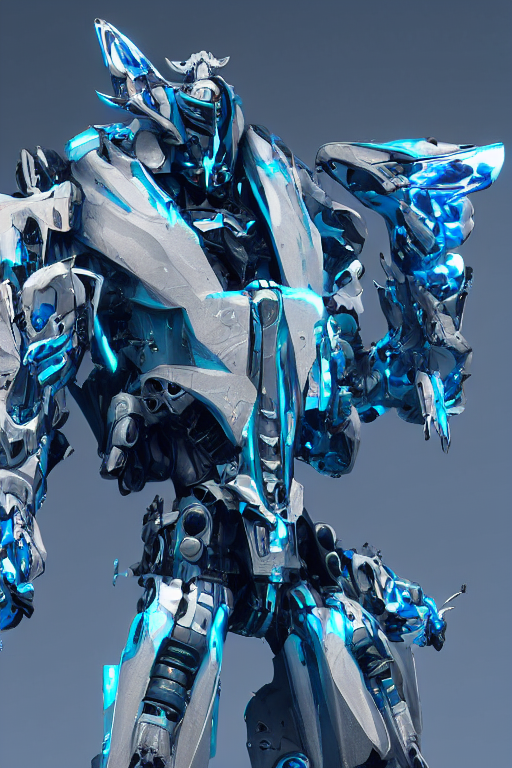

In [ ]:
image = df['image'][2]
image

In [ ]:
example = 712
df['prompt'][example]

'portrait girl alchemist blue dress witch hat fantasi dungeon dragon ultrafin detail paint chibi detail paint bori valejo octopath travel decal'

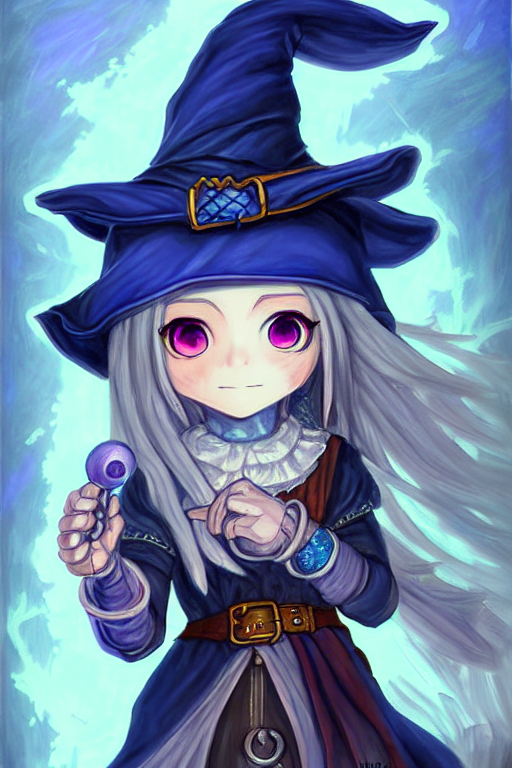

In [ ]:
df['image'][example]

In [ ]:
# "similar_prompts" code:
import numpy as np
from PIL import Image

def similar_prompts(topN, sim_mat, ID):
    """
    --- Inputs ---
    topN: the number of prompts to be recommended
    sim_mat: similarity matrix. This should be a square matrix
    ID: id of the prompt
    --- Output ---
    Input prompt df['prompt'][random] and input image df['prompt'][random]
    topN similar prompts
    """
    temp_prompt = sim_mat[ID]
    index_after_sort = np.argsort(temp_prompt)[::-1]
    index_after_sort = index_after_sort[index_after_sort != ID][:topN]  # Exclude the input prompt
    print('input Sr. No: ', ID)
    print('input prompt: ', df['prompt'][ID])
    print('input image')
    display(df['image'][ID])

    for i in index_after_sort:
        print('Recommended Sr. No: ', i)
        print('Recommended prompt: ', df['prompt'][i])
        print('Recommended image')
        display(df['image'][i])

In [ ]:
# "clustering_coefficient" code
import networkx as nx

def create_graph(correlation_matrix, threshold):
    G = nx.Graph()
    for i in range(len(correlation_matrix)):
        for j in range(i+1, len(correlation_matrix)):
            if correlation_matrix[i][j] >= threshold:
                G.add_edge(i, j, weight=correlation_matrix[i][j])
    return G

def clustering_coefficient(correlation_matrix, threshold):
    G = create_graph(correlation_matrix, threshold)
    avg_clustering_coefficient = nx.average_clustering(G)
    return avg_clustering_coefficient

In [ ]:
# plot "spring_layout" GRAPH
import networkx as nx
import matplotlib.pyplot as plt

def draw_graph_spring(correlation_matrix, threshold):
    G = nx.Graph()

    for i in range(len(correlation_matrix)):
        for j in range(i+1, len(correlation_matrix)):
            if correlation_matrix[i][j] >= threshold:
                G.add_edge(i, j, weight=correlation_matrix[i][j])

    pos = nx.spring_layout(G, seed=42, scale=5)
    nx.draw(G, pos, with_labels=True, node_color='lightblue', edge_color='gray', node_size=1000, font_size=8)
    
    # Draw edges with transparency to better visualize connections
    edge_labels = nx.get_edge_attributes(G, 'weight')
    nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_size=8, alpha=0.5)
    plt.show()

In [ ]:
# "kamada_kawai_layout" GRAPH
import networkx as nx
import matplotlib.pyplot as plt

def draw_graph_Kamada_Kawai(correlation_matrix, threshold):
    G = nx.Graph()

    for i in range(len(correlation_matrix)):
        for j in range(i+1, len(correlation_matrix)):
            if correlation_matrix[i][j] >= threshold:
                G.add_edge(i, j, weight=correlation_matrix[i][j])

    # Use the Kamada-Kawai path-length cost function for the layout
    pos = nx.kamada_kawai_layout(G, scale=5)
    
    nx.draw(G, pos, with_labels=True, node_color='lightblue', edge_color='gray', node_size=1000, font_size=8)
    
    # Draw edges with transparency to better visualize connections
    edge_labels = nx.get_edge_attributes(G, 'weight')
    nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_size=8, alpha=0.5)
    plt.show()

In [ ]:
# "Circular_layout" GRAPH
import networkx as nx
import matplotlib.pyplot as plt

def draw_graph_circular(correlation_matrix, threshold):
    G = nx.Graph()

    for i in range(len(correlation_matrix)):
        for j in range(i+1, len(correlation_matrix)):
            if correlation_matrix[i][j] >= threshold:
                G.add_edge(i, j, weight=correlation_matrix[i][j])

    pos = nx.circular_layout(G)
    
    nx.draw(G, pos, with_labels=True, node_color='lightblue', edge_color='gray', node_size=1000, font_size=8)
    
    edge_labels = nx.get_edge_attributes(G, 'weight')
    nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_size=8, alpha=0.5)
    
    plt.show()

In [ ]:
# Import Libraries
import pandas as pd
import numpy as np
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity, cosine_distances
import gensim.downloader as api
from transformers import CLIPProcessor, CLIPModel
from PIL import Image

"Tf_sim" represents the cosine similarity between the text data based on the Term Frequency-Inverse Document Frequency (TF-IDF) representation.

"CV_sim" represents the cosine similarity based on the CountVectorizer representation (Bag of Words). 

They are both similarity measures based on text data, but they use different representations.

# Model 1.1: "CV_sim" represents the cosine similarity based on the CountVectorizer representation (Bag of Words).

# Model 1.1: CV_sim Model

In [ ]:
import random
from sklearn.feature_extraction.text import TfidfVectorizer

# Bag of words
vectorizer = CountVectorizer()
bag_of_words = vectorizer.fit_transform(df['prompt'])
CV_sim = cosine_similarity(bag_of_words)
CV_sim

array([[1.        , 0.24324324, 0.        , ..., 0.        , 0.15042366,
        0.23995691],
       [0.24324324, 1.        , 0.03224129, ..., 0.        , 0.12535305,
        0.23995691],
       [0.        , 0.03224129, 1.        , ..., 0.        , 0.        ,
        0.04089304],
       ...,
       [0.        , 0.        , 0.        , ..., 1.        , 0.        ,
        0.        ],
       [0.15042366, 0.12535305, 0.        , ..., 0.        , 1.        ,
        0.0635963 ],
       [0.23995691, 0.23995691, 0.04089304, ..., 0.        , 0.0635963 ,
        1.        ]])

Average clustering coefficient: 0.7797147808349096
graph_spring_Layout
graph_Kamada_Kawai_Layout
graph_circular_Layout
Top N recoemmendations
input Sr. No:  712
input prompt:  portrait girl alchemist blue dress witch hat fantasi dungeon dragon ultrafin detail paint chibi detail paint bori valejo octopath travel decal
input image


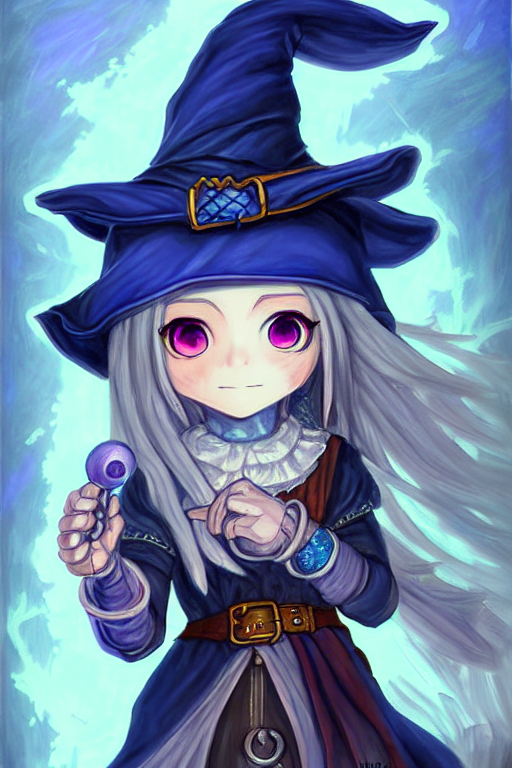

Recommended Sr. No:  705
Recommended prompt:  carolingian paint show figur man hold flag francisco de zurbaran polycount renaiss da vinci academ art detail paint
Recommended image


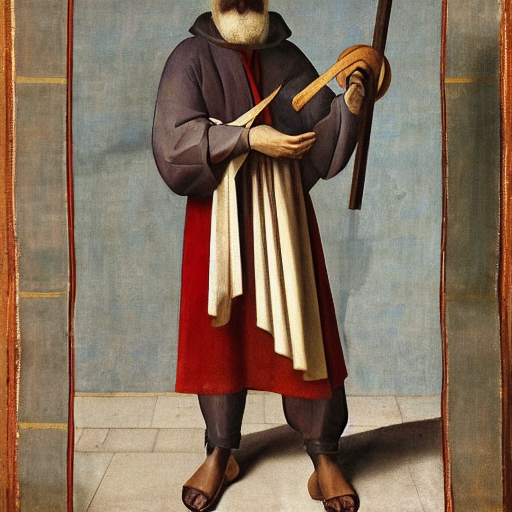

Recommended Sr. No:  983
Recommended prompt:  incred detail plasticin sculptur knight armor
Recommended image


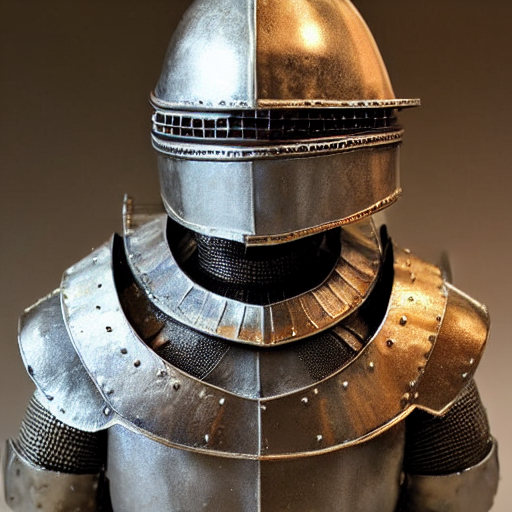

Recommended Sr. No:  981
Recommended prompt:  concept art dragon attack lovecraftian lot teeth melt horror feather fight horror unknown laser gun
Recommended image


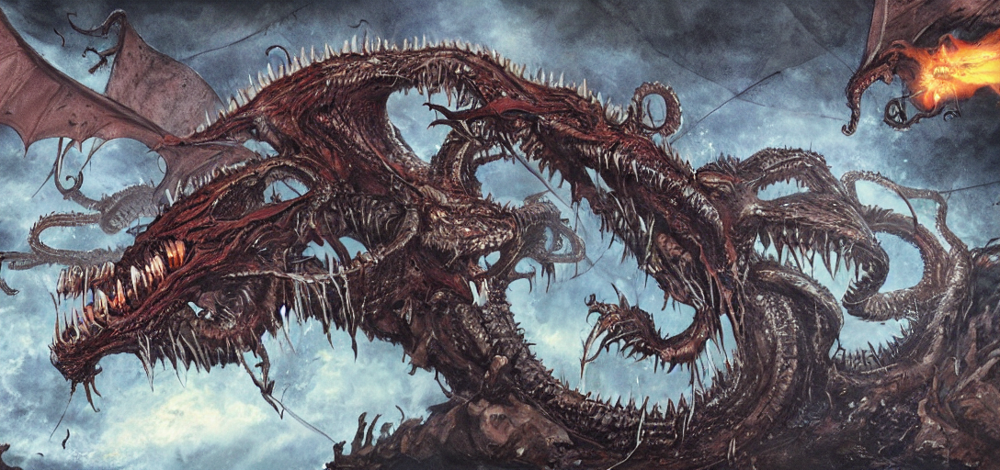

In [ ]:
similarity_matrix = CV_sim
threshold = 0.7
top_N = 3
example = 712
print("Average clustering coefficient:", clustering_coefficient(similarity_matrix, threshold))
print("graph_spring_Layout")
#draw_graph_spring(similarity_matrix, threshold)
print("graph_Kamada_Kawai_Layout")
#draw_graph_Kamada_Kawai(similarity_matrix, threshold)
print("graph_circular_Layout")
#draw_graph_circular(similarity_matrix, threshold)
print("Top N recoemmendations")
similar_prompts(top_N, similarity_matrix, example)

# Save graph as gexf file
graph_CV_sim = create_graph(similarity_matrix, threshold)
nx.write_gexf(graph_CV_sim, "graph_CV_sim.gexf")

# Model 1.2: "Tf_sim" Term Frequency-Inverse Document Frequency (TF-IDF) Model

In [ ]:
# TF-IDF
tfidf_vectorizer = TfidfVectorizer()
tfidf_matrix = tfidf_vectorizer.fit_transform(df['prompt'])
Tf_sim = cosine_similarity(tfidf_matrix)
Tf_sim

array([[1.        , 0.07932207, 0.        , ..., 0.        , 0.0358418 ,
        0.07385337],
       [0.07932207, 1.        , 0.00705773, ..., 0.        , 0.04349302,
        0.07275612],
       [0.        , 0.00705773, 1.        , ..., 0.        , 0.        ,
        0.06784416],
       ...,
       [0.        , 0.        , 0.        , ..., 1.        , 0.        ,
        0.        ],
       [0.0358418 , 0.04349302, 0.        , ..., 0.        , 1.        ,
        0.01563342],
       [0.07385337, 0.07275612, 0.06784416, ..., 0.        , 0.01563342,
        1.        ]])

Average clustering coefficient: 0.7267153744170671
graph_spring_Layout
graph_Kamada_Kawai_Layout
graph_circular_Layout
Top N recoemmendations
input Sr. No:  712
input prompt:  portrait girl alchemist blue dress witch hat fantasi dungeon dragon ultrafin detail paint chibi detail paint bori valejo octopath travel decal
input image


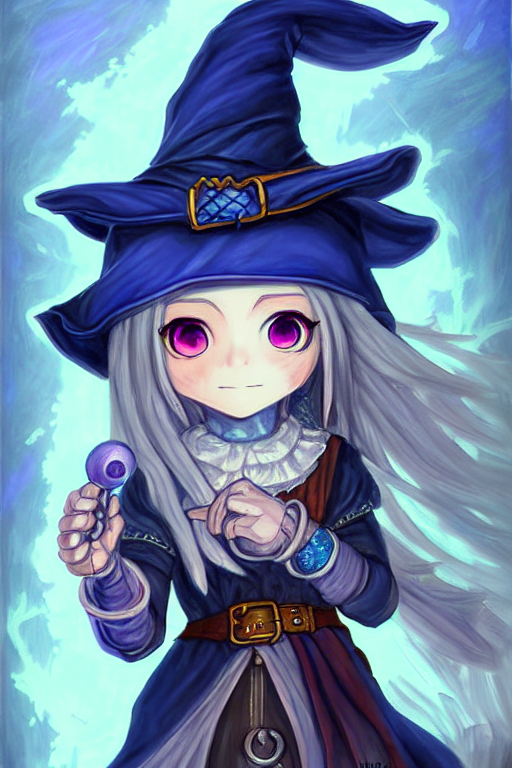

Recommended Sr. No:  981
Recommended prompt:  concept art dragon attack lovecraftian lot teeth melt horror feather fight horror unknown laser gun
Recommended image


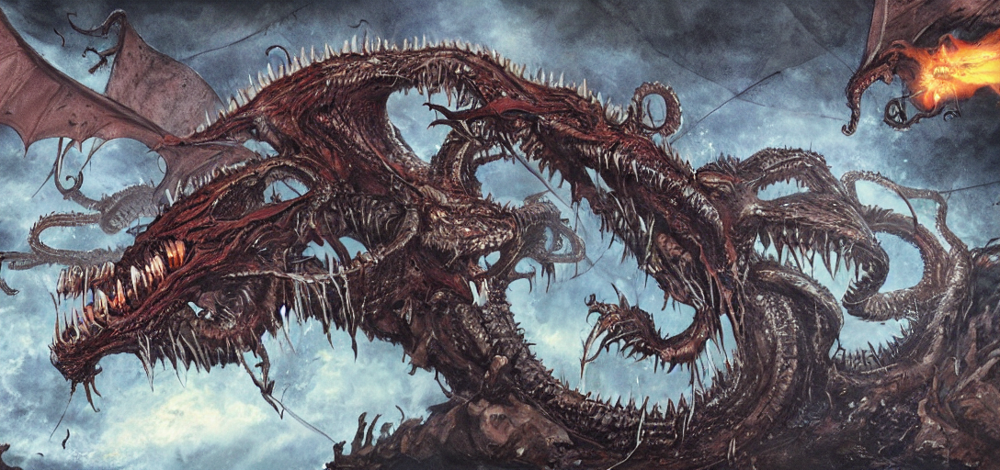

Recommended Sr. No:  705
Recommended prompt:  carolingian paint show figur man hold flag francisco de zurbaran polycount renaiss da vinci academ art detail paint
Recommended image


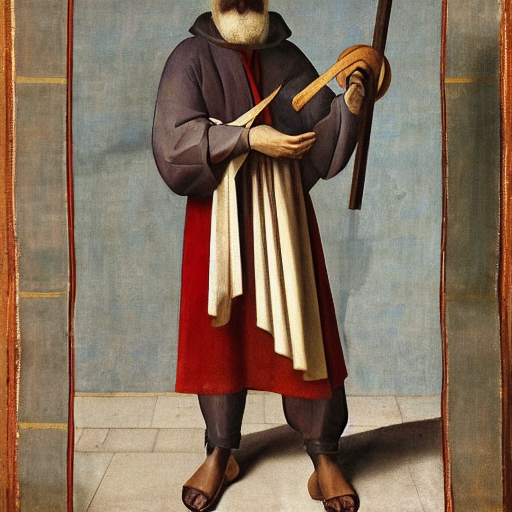

Recommended Sr. No:  983
Recommended prompt:  incred detail plasticin sculptur knight armor
Recommended image


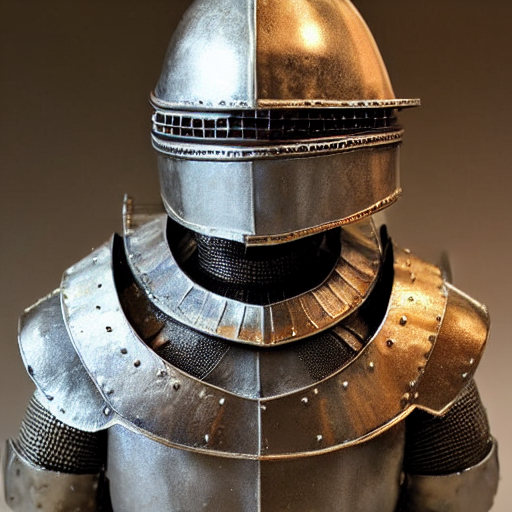

In [ ]:
similarity_matrix = Tf_sim
threshold = 0.7
top_N = 3
example = 712
print("Average clustering coefficient:", clustering_coefficient(similarity_matrix, threshold))
print("graph_spring_Layout")
# draw_graph_spring(similarity_matrix, threshold)
print("graph_Kamada_Kawai_Layout")
#draw_graph_Kamada_Kawai(similarity_matrix, threshold)
print("graph_circular_Layout")
#draw_graph_circular(similarity_matrix, threshold)
print("Top N recoemmendations")
similar_prompts(top_N, similarity_matrix, example)

# Save graph as gexf file
graph_Tf_sim = create_graph(similarity_matrix, threshold)
nx.write_gexf(graph_Tf_sim, "graph_Tf_sim.gexf")

# Model 3.1: "word2vec_model" based on Word embeddings and distance metrics

In [ ]:
import gensim.downloader as api
from sklearn.metrics.pairwise import cosine_similarity

# Model 3.1 - Word embeddings and distance metrics
word2vec_model = api.load("word2vec-google-news-300")
df['embedding'] = df['prompt'].apply(lambda prompt: np.mean([word2vec_model[word] for word in prompt.split() if word in word2vec_model], axis=0))
# Filter out any empty embeddings
df = df[df['embedding'].apply(lambda x: x.shape[0] == 300)]
# Calculate cosine similarity
word2vec_sim = cosine_similarity(np.vstack(df['embedding'].values))
word2vec_sim

array([[0.9999999 , 0.6771937 , 0.50716305, ..., 0.3278184 , 0.57216245,
        0.6320239 ],
       [0.6771937 , 1.0000002 , 0.59265   , ..., 0.4631496 , 0.5912927 ,
        0.64352834],
       [0.50716305, 0.59265   , 1.0000005 , ..., 0.32655695, 0.534514  ,
        0.54855925],
       ...,
       [0.3278184 , 0.4631496 , 0.32655695, ..., 1.0000002 , 0.26641297,
        0.36146232],
       [0.57216245, 0.5912927 , 0.534514  , ..., 0.26641297, 0.9999998 ,
        0.5015744 ],
       [0.6320239 , 0.64352834, 0.54855925, ..., 0.36146232, 0.5015744 ,
        1.0000002 ]], dtype=float32)

Average clustering coefficient: 0.6447482433961641
graph_spring_Layout
graph_Kamada_Kawai_Layout
graph_circular_Layout
Top N recoemmendations
input Sr. No:  712
input prompt:  portrait girl alchemist blue dress witch hat fantasi dungeon dragon ultrafin detail paint chibi detail paint bori valejo octopath travel decal
input image


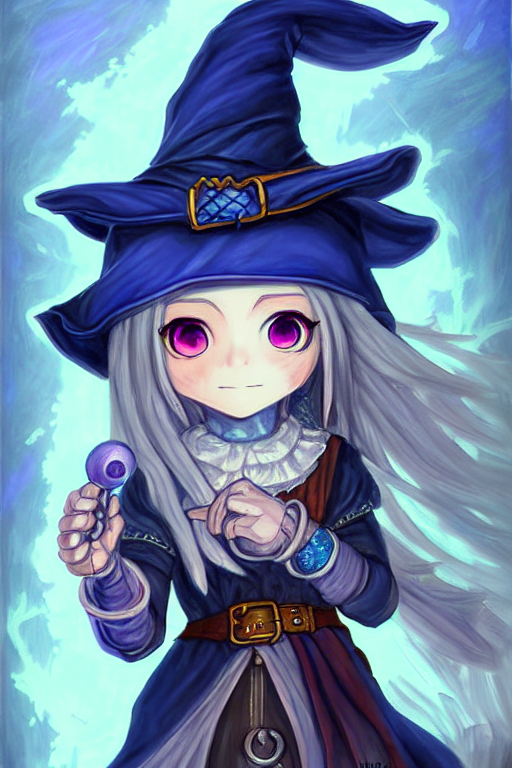

Recommended Sr. No:  983
Recommended prompt:  incred detail plasticin sculptur knight armor
Recommended image


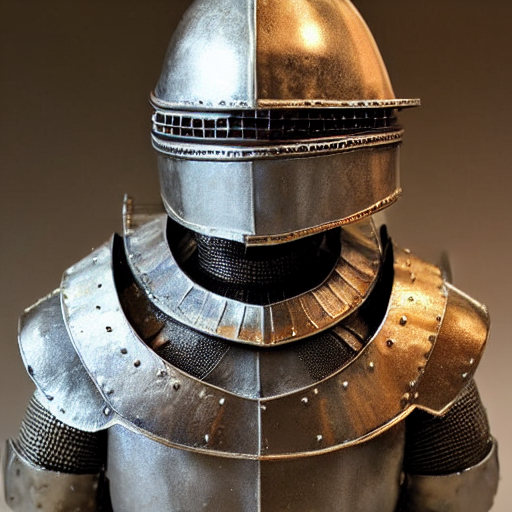

Recommended Sr. No:  981
Recommended prompt:  concept art dragon attack lovecraftian lot teeth melt horror feather fight horror unknown laser gun
Recommended image


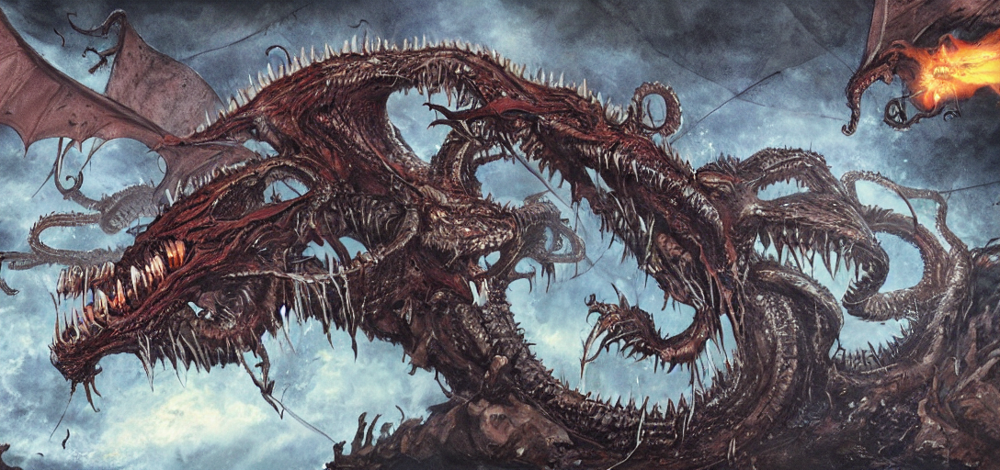

Recommended Sr. No:  705
Recommended prompt:  carolingian paint show figur man hold flag francisco de zurbaran polycount renaiss da vinci academ art detail paint
Recommended image


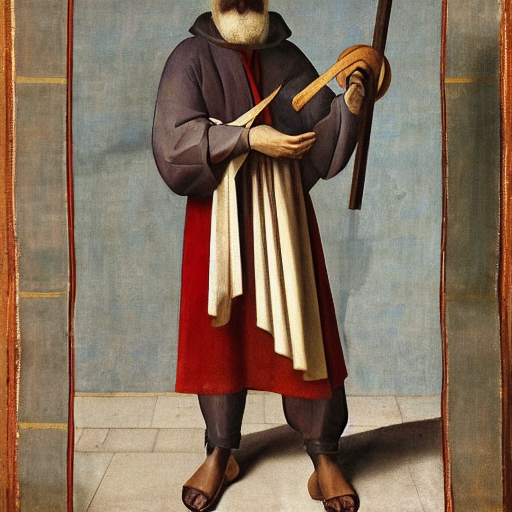

In [ ]:
similarity_matrix = word2vec_sim
threshold = 0.7
top_N = 3
example = 712
print("Average clustering coefficient:", clustering_coefficient(similarity_matrix, threshold))
print("graph_spring_Layout")
#draw_graph_spring(similarity_matrix, threshold)
print("graph_Kamada_Kawai_Layout")
#draw_graph_Kamada_Kawai(similarity_matrix, threshold)
print("graph_circular_Layout")
#draw_graph_circular(similarity_matrix, threshold)
print("Top N recoemmendations")
similar_prompts(top_N, similarity_matrix, example)


# Save graph as gexf file
graph_word2vec_sim = create_graph(similarity_matrix, threshold)
nx.write_gexf(graph_word2vec_sim, "graph_word2vec_sim.gexf")

# Model 3.2: "glove_model"

In [ ]:
# Model 3.2: "glove_model"
import gensim.downloader as api
from sklearn.metrics.pairwise import cosine_similarity

# Step 3: Model 3 - Word embeddings and distance metrics
glove_model = api.load("glove-wiki-gigaword-300")

def mean_embedding(prompt):
    embeddings = [glove_model[word] for word in prompt.split() if word in glove_model]
    return np.mean(embeddings, axis=0) if embeddings else None

df['embedding'] = df['prompt'].apply(mean_embedding)
# Filter out any empty embeddings
df = df[df['embedding'].notna()]
# Calculate cosine similarity
glove_model_sim = cosine_similarity(np.vstack(df['embedding'].values))
glove_model_sim


array([[0.9999997 , 0.583752  , 0.28238702, ..., 0.12448497, 0.46041366,
        0.6448652 ],
       [0.583752  , 0.99999976, 0.32146445, ..., 0.12460096, 0.5219027 ,
        0.5530432 ],
       [0.28238702, 0.32146445, 1.        , ..., 0.08279271, 0.34700164,
        0.3807121 ],
       ...,
       [0.12448497, 0.12460096, 0.08279271, ..., 1.        , 0.0275149 ,
        0.17394112],
       [0.46041366, 0.5219027 , 0.34700164, ..., 0.0275149 , 1.0000002 ,
        0.44310254],
       [0.6448652 , 0.5530432 , 0.3807121 , ..., 0.17394112, 0.44310254,
        0.99999994]], dtype=float32)

Average clustering coefficient: 0.69153287115038
graph_spring_Layout
graph_Kamada_Kawai_Layout
graph_circular_Layout
Top N recoemmendations
input Sr. No:  712
input prompt:  portrait girl alchemist blue dress witch hat fantasi dungeon dragon ultrafin detail paint chibi detail paint bori valejo octopath travel decal
input image


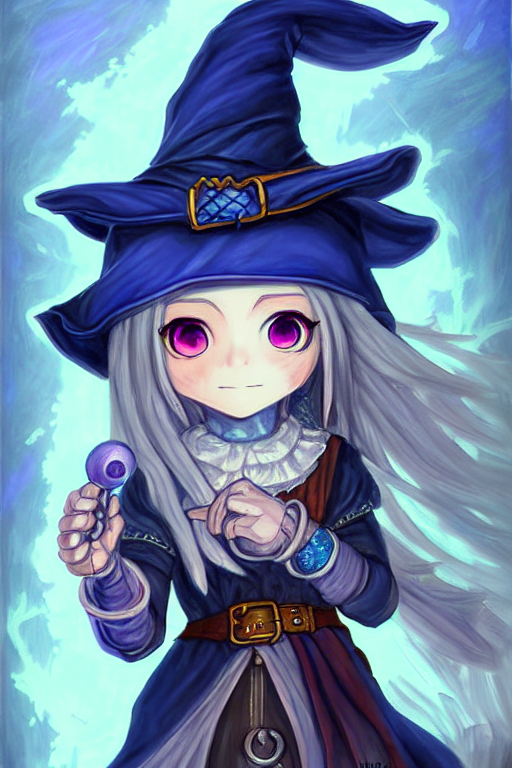

Recommended Sr. No:  725
Recommended prompt:  poignant portrait older man rememb youth year weigh heavili eye nostalgia melancholi grief accept peac hope
Recommended image


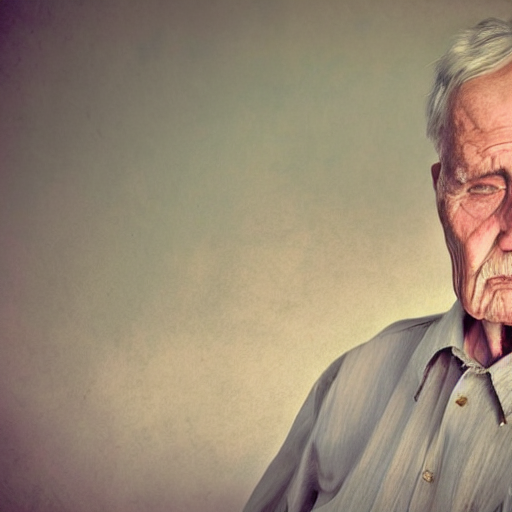

Recommended Sr. No:  761
Recommended prompt:  portrait girl bard pink hero costum fantasi dungeon dragon ultrafin detail paint chibi detail paint bori valejo octopath travel decal
Recommended image


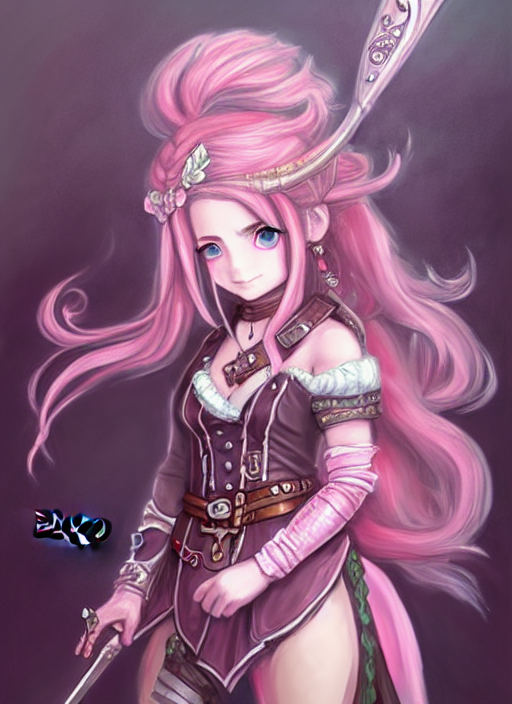

Recommended Sr. No:  727
Recommended prompt:  man look outrunsun outrun outrun sun high detail dark wlop
Recommended image


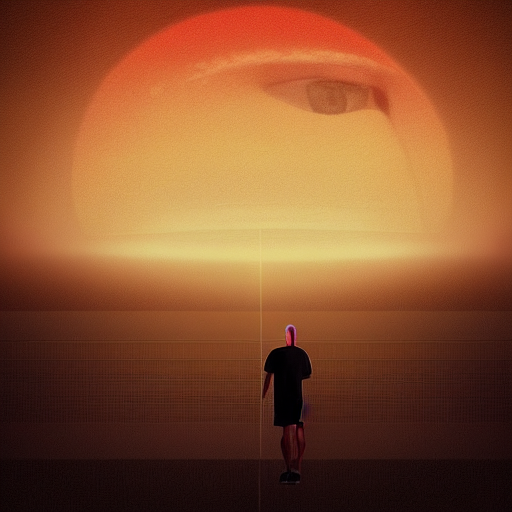

In [ ]:
similarity_matrix = glove_model_sim
threshold = 0.7
top_N = 3
example = 712
print("Average clustering coefficient:", clustering_coefficient(similarity_matrix, threshold))
print("graph_spring_Layout")
#draw_graph_spring(similarity_matrix, threshold)
print("graph_Kamada_Kawai_Layout")
#draw_graph_Kamada_Kawai(similarity_matrix, threshold)
print("graph_circular_Layout")
#draw_graph_circular(similarity_matrix, threshold)
print("Top N recoemmendations")
similar_prompts(top_N, similarity_matrix, example)

# Save graph as gexf file
graph_glove_model_sim = create_graph(similarity_matrix, threshold)
nx.write_gexf(graph_glove_model_sim, "graph_glove_model_sim.gexf")

# Model 3.3: "bert" model

In [ ]:
# Model 3.3: "bert" model

# To compute the cosine similarity matrix for BERT embeddings, you need to first tokenize the prompts and then obtain embeddings from the BERT model. Here's the updated code:
from transformers import AutoTokenizer, AutoModel
import torch
from sklearn.metrics.pairwise import cosine_similarity

# Load tokenizer and model
tokenizer = AutoTokenizer.from_pretrained("bert-base-uncased")
bert_model = AutoModel.from_pretrained("bert-base-uncased")

# Function to get BERT embeddings
def get_bert_embedding(prompts):
    inputs = tokenizer(prompts, return_tensors="pt", max_length=512, truncation=True, padding="max_length")
    outputs = bert_model(**inputs)
    return outputs.last_hidden_state[:, 0, :].detach().numpy()

# Process prompts in batches
batch_size = 64
embeddings = []

for i in range(0, len(df), batch_size):
    batch = df['prompt'][i:i+batch_size].tolist()
    embeddings.extend(get_bert_embedding(batch))

df['embedding'] = embeddings

# Filter out any empty embeddings
df = df[df['embedding'].apply(lambda x: x.shape[0] == 768)]

# Calculate cosine similarity
bert_model_sim = cosine_similarity(np.vstack(df['embedding'].values))
bert_model_sim

# This code loads the BERT tokenizer and model using the from_pretrained method, defines a function get_bert_embedding to obtain BERT embeddings, and computes the cosine similarity matrix, storing it in the variable bert_model_sim.


Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.seq_relationship.bias', 'cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


array([[1.0000001 , 0.91195285, 0.8110382 , ..., 0.8598559 , 0.850325  ,
        0.90651673],
       [0.91195285, 0.99999994, 0.88907623, ..., 0.8545961 , 0.8885767 ,
        0.94961536],
       [0.8110382 , 0.88907623, 1.0000002 , ..., 0.8158187 , 0.83857226,
        0.9172827 ],
       ...,
       [0.8598559 , 0.8545961 , 0.8158187 , ..., 0.99999994, 0.8313956 ,
        0.88857913],
       [0.850325  , 0.8885767 , 0.83857226, ..., 0.8313956 , 0.99999976,
        0.86355203],
       [0.90651673, 0.94961536, 0.9172827 , ..., 0.88857913, 0.86355203,
        0.9999999 ]], dtype=float32)

In [ ]:
similarity_matrix = bert_model_sim
threshold = 0.7
top_N = 3
example = 712
print("Average clustering coefficient:", clustering_coefficient(similarity_matrix, threshold))

KeyboardInterrupt: ignored

In [ ]:
similarity_matrix = bert_model_sim
threshold = 0.7
top_N = 3
example = 712
print("Average clustering coefficient:", clustering_coefficient(similarity_matrix, threshold))
#print("graph_spring_Layout")
#draw_graph_spring(similarity_matrix, threshold)
print("graph_Kamada_Kawai_Layout")
#draw_graph_Kamada_Kawai(similarity_matrix, threshold)
print("graph_circular_Layout")
#draw_graph_circular(similarity_matrix, threshold)
print("Top N recoemmendations")
similar_prompts(top_N, similarity_matrix, example)


KeyboardInterrupt



In [ ]:
# Create Graph
graph_bert_model_sim = create_graph(similarity_matrix, threshold)

In [ ]:
# Create Graph
threshold = 0.9
graph_bert_model_sim = create_graph(similarity_matrix, threshold)
# Save graph as GEXF file
nx.write_gexf(graph_bert_model_sim, "graph_bert_model_sim.gexf")

In [ ]:
import os

gexf_filename = "graph_bert_model_sim.gexf"
file_path = os.path.join(os.getcwd(), gexf_filename)

print(f"The file path of the GEXF file is: {file_path}")


The file path of the GEXF file is: /Users/spartan/graph_bert_model_sim.gexf


# Model 4: Object detection using CLIP

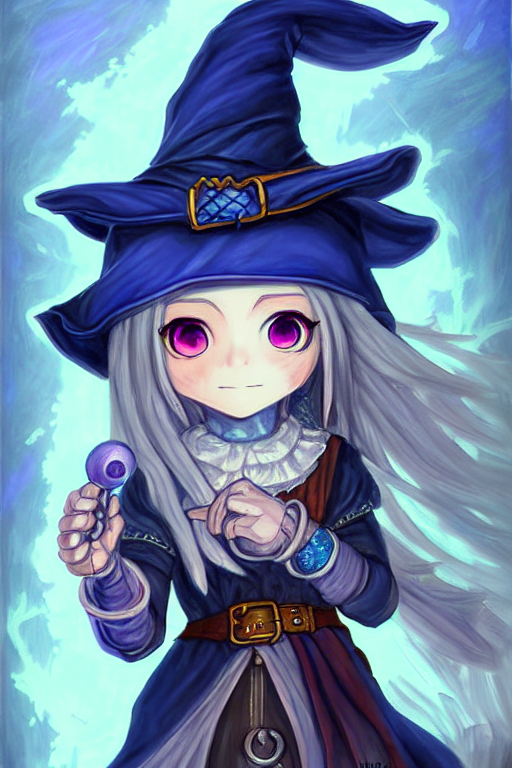

In [ ]:
df['image'][712]

In [ ]:
! pip install torchvision

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 6.9 MB/s eta 0:00:00


In [ ]:
# Model 4: Object detection using CLIP
from transformers import CLIPProcessor, CLIPModel
import torch
from sklearn.metrics.pairwise import cosine_similarity

clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")
clip_model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")

from PIL import Image
import torchvision.transforms as transforms

transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize((0.48145466, 0.4578275, 0.40821073), (0.26862954, 0.26130258, 0.27577711)),
])

def image_to_clip_features(image):
    if not isinstance(image, Image.Image):
        return np.zeros(512)
    
    try:
        image_tensor = transform(image).unsqueeze(0)
        
        with torch.no_grad():
            outputs = clip_model.get_image_features(image_tensor)
            features = outputs.cpu().numpy()

        # Check if all extracted features are zero
        if np.all(features[0] == 0):
            print(f"This is an issue: All extracted features for the image are zero.")
        return features[0]
    except Exception as e:
        print(f"Error processing image: {e}")
        return np.zeros(512)


# Apply the function to the 'image' column
df['clip_features'] = df['image'].apply(image_to_clip_features)

CLIP_sim = cosine_similarity(np.vstack(df['clip_features'].values))
CLIP_sim

Clip features:
0       [0.12623587, 0.3453827, 0.3777396, 0.6374375, ...
1       [0.21597773, 0.40600914, -0.17611496, 0.045497...
2       [-0.012694795, 0.2629228, -0.684528, -0.087327...
3       [0.34797412, -0.08207062, 0.220535, 0.29276913...
4       [0.31157988, -0.117720336, -0.28721067, 0.3072...
                              ...                        
4995    [0.2955039, -0.089038, 0.32616827, 0.10105997,...
4996    [-0.2510733, 0.24769516, -0.019087948, 0.59489...
4997    [-0.17071675, -0.027742669, -0.1564154, 0.5314...
4998    [-0.105011016, -0.025212526, -0.13729075, -0.2...
4999    [0.22376052, -0.02654846, -0.42269278, -0.0663...
Name: clip_features, Length: 4953, dtype: object


array([[1.0000004 , 0.56309855, 0.5705913 , ..., 0.5445298 , 0.5366535 ,
        0.59356993],
       [0.56309855, 0.99999994, 0.590752  , ..., 0.6091561 , 0.587727  ,
        0.7218987 ],
       [0.5705913 , 0.590752  , 1.0000004 , ..., 0.5504021 , 0.57596403,
        0.7733289 ],
       ...,
       [0.5445298 , 0.6091561 , 0.5504021 , ..., 1.0000005 , 0.6874025 ,
        0.57456577],
       [0.5366535 , 0.587727  , 0.57596403, ..., 0.6874025 , 1.0000002 ,
        0.572279  ],
       [0.59356993, 0.7218987 , 0.7733289 , ..., 0.57456577, 0.572279  ,
        0.9999997 ]], dtype=float32)

In [ ]:
# Save graph as GEXF file
threshold = 0.9
CLIP_sim = create_graph(similarity_matrix, threshold)
nx.write_gexf(graph_CLIP_sim, "graph_CLIP_sim.gexf")

In [ ]:
import os

gexf_filename = "graph_CLIP_sim.gexf"
file_path = os.path.join(os.getcwd(), gexf_filename)

print(f"The file path of the GEXF file is: {file_path}")

The file path of the GEXF file is: /Users/spartan/graph_CLIP_sim.gexf


Average clustering coefficient: 0.5452121864741246
graph_spring_Layout
graph_Kamada_Kawai_Layout
graph_circular_Layout
Top N recoemmendations
input Sr. No:  712
input prompt:  portrait girl alchemist blue dress witch hat fantasi dungeon dragon ultrafin detail paint chibi detail paint bori valejo octopath travel decal
input image


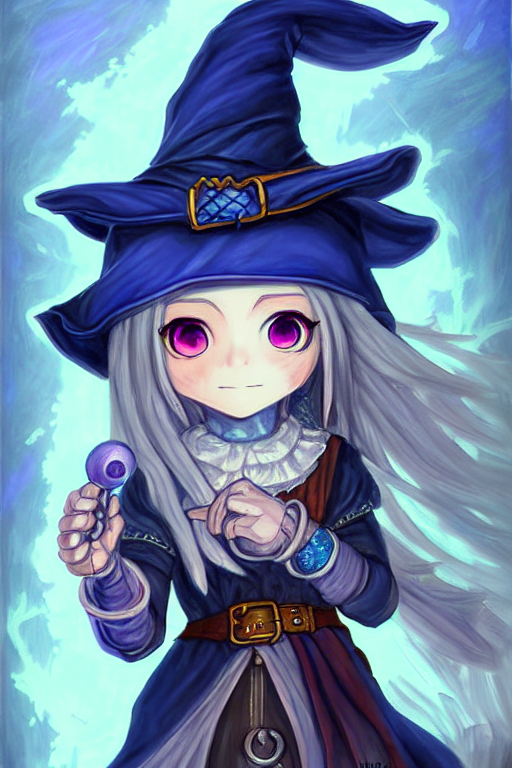

Recommended Sr. No:  1054
Recommended prompt:  photo illustr ghibli paint small sci fi machin shop ship contain sci fi cyberpunk neon light noir digit photographi intric detail unreal engin k volumetr light artstat draw fox pictur
Recommended image


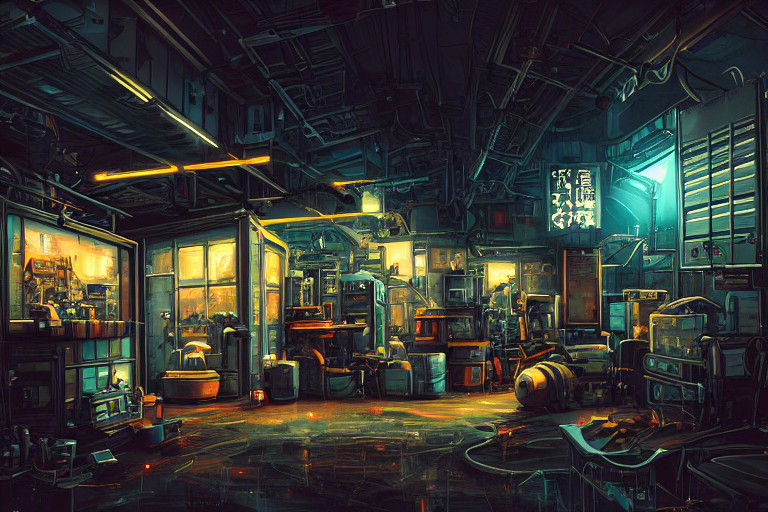

Recommended Sr. No:  990
Recommended prompt:  huge wooden carv sculptur fox intric detail photograph sharp focu depth field cinemat light
Recommended image


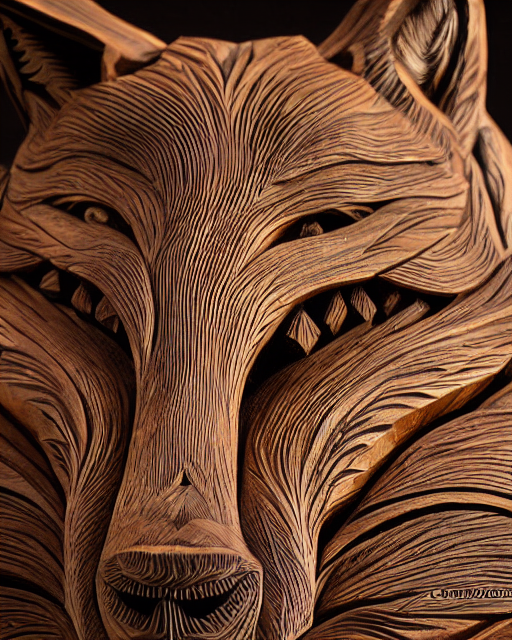

Recommended Sr. No:  1215
Recommended prompt:  robot code screen old video game shown robot play control
Recommended image


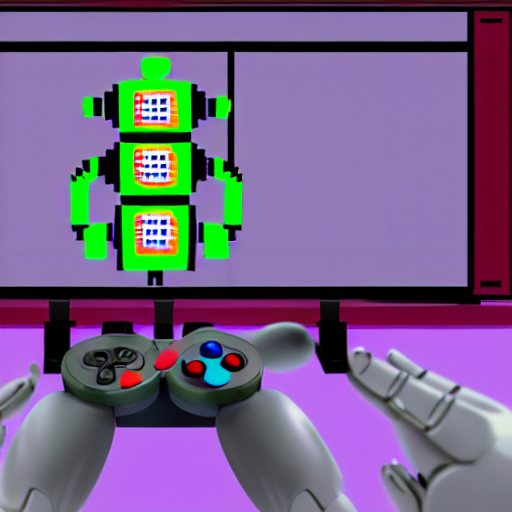

In [ ]:
similarity_matrix = CLIP_sim
threshold = 0.7
top_N = 3
example = 712
print("Average clustering coefficient:", clustering_coefficient(similarity_matrix, threshold))
print("graph_spring_Layout")
#draw_graph_spring(similarity_matrix, threshold)
print("graph_Kamada_Kawai_Layout")
#draw_graph_Kamada_Kawai(similarity_matrix, threshold)
print("graph_circular_Layout")
#draw_graph_circular(similarity_matrix, threshold)
print("Top N recoemmendations")
similar_prompts(top_N, similarity_matrix, example)

# Save graph as GEXF file
graph_CLIP_sim = create_graph(similarity_matrix, threshold)
nx.write_gexf(graph_CLIP_sim, "graph_CLIP_sim.gexf")

#Final: Ensemble Model

In [ ]:
# Step 5: Combine similarity scores and recommend prompts
import numpy as np

# Combine the similarity matrices
ensemble_sim = (np.array(bert_model_sim) + np.array(CLIP_sim)) / 2

threshold = 0.9
# Create graph for the ensemble model
ensemble_BERT_CLIP_sim = create_graph(ensemble_sim, threshold)

# Save graph as GEXF file
nx.write_gexf(ensemble_BERT_CLIP_sim, "ensemble_BERT_CLIP_sim.gexf")

Model 5) NLP entity recognition and refined recommendations:
-- Use NLP libraries like Spacy or NLTK to process the prompt text and extract entities (e.g., using BIOES or other entity recognition models).

-- Encode these entities as features, and compute the pairwise distances between the input prompt and all other prompts using a distance metric.
-- Combine these distance scores with the similarity scores from one of the previous models (e.g., Model 3) using a weighted average.
-- Recommend the prompts with the highest combined scores.
Python libraries: Spacy, NLTK
